In [ ]:
from google.colab import files
files.upload()

Saving kaggle.json to kaggle.json


{'kaggle.json': b'{"username":"muhammetmesutbay","key":"7ade1bb4f0268c73abd3be2ad8a5dc93"}'}

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle datasets download -d jangedoo/utkface-new

Dataset URL: https://www.kaggle.com/datasets/jangedoo/utkface-new
License(s): copyright-authors
 99% 329M/331M [00:17<00:00, 25.1MB/s]
100% 331M/331M [00:17<00:00, 19.6MB/s]


In [ ]:
!unzip utkface-new.zip -d utkface

Görüntülenen çıkış son 5000 satıra kısaltıldı.
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_0_20170109004755204.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_0_20170111182452832.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_1_20170103230340961.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_1_20170104011329697.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_1_20170104165020320.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_1_20170108230211421.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_2_20170104022134829.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_2_20170104023010725.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_2_20170104172537171.jpg.chip.jpg  
  inflating: utkface/utkface_aligned_cropped/crop_part1/34_1_2_20170104201443273.jpg.chip

In [ ]:
import os
print(os.listdir())

['.config', 'kaggle.json', 'utkface', 'utkface-new.zip', 'sample_data']


In [ ]:
print(os.listdir('utkface'))

['UTKFace', 'utkface_aligned_cropped', 'crop_part1']


In [ ]:
import os
import pandas as pd
import numpy as np
from PIL import Image
from sklearn.model_selection import train_test_split
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras import optimizers
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, ReduceLROnPlateau, TensorBoard
import seaborn as sns
import random
import matplotlib.pyplot as plt
from sklearn.utils import resample

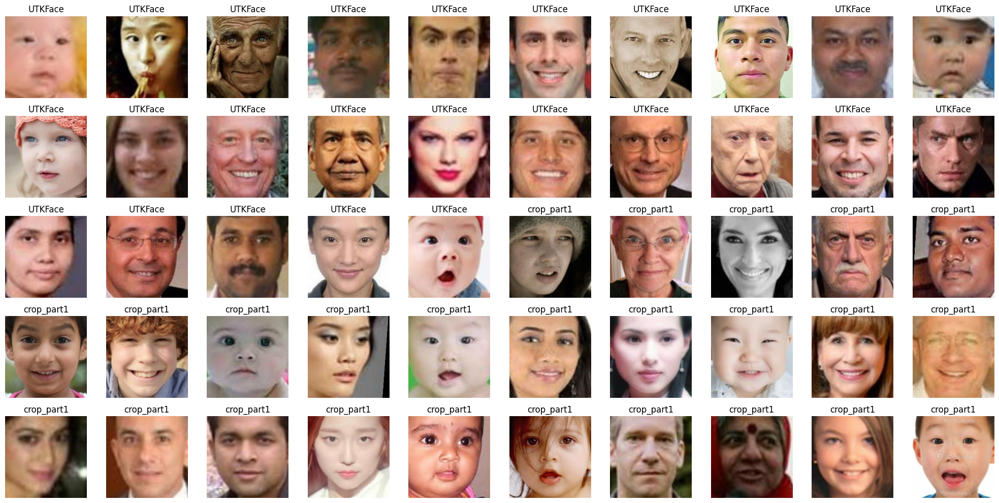

In [ ]:
data_dir = 'utkface'
utkface_dir = os.path.join(data_dir, 'UTKFace')
crop_part1_dir = os.path.join(data_dir, 'crop_part1')

def select_random_images(directory, num_images):
    images = []
    files = os.listdir(directory)
    selected_files = random.sample(files, num_images)
    for file in selected_files:
        img_path = os.path.join(directory, file)
        img = Image.open(img_path)
        images.append(img)
    return images

utkface_images = select_random_images(utkface_dir, 25)
crop_part1_images = select_random_images(crop_part1_dir, 25)

fig, axes = plt.subplots(5, 10, figsize=(20, 10))

for i, ax in enumerate(axes.flatten()):
    if i < 25:
        ax.imshow(utkface_images[i])
        ax.set_title('UTKFace')
    else:
        ax.imshow(crop_part1_images[i - 25])
        ax.set_title('crop_part1')
    ax.axis('off')

plt.tight_layout()
plt.show()


In [ ]:
utkface_dir = 'utkface/UTKFace'
crop_part1_dir = 'utkface/crop_part1'

images = []
ages = []
genders = []

In [ ]:
for i in os.listdir(utkface_dir):
    split = i.split('_')
    ages.append(int(split[0]))
    genders.append(int(split[1]))
    images.append(Image.open(os.path.join(utkface_dir, i)))

for i in os.listdir(crop_part1_dir):
    split = i.split('_')
    ages.append(int(split[0]))
    genders.append(int(split[1]))
    images.append(Image.open(os.path.join(crop_part1_dir, i)))

In [ ]:
images = pd.Series(images, name='Images')
ages = pd.Series(ages, name='Ages')
genders = pd.Series(genders, name='Genders')

df = pd.concat([images, ages, genders], axis=1)

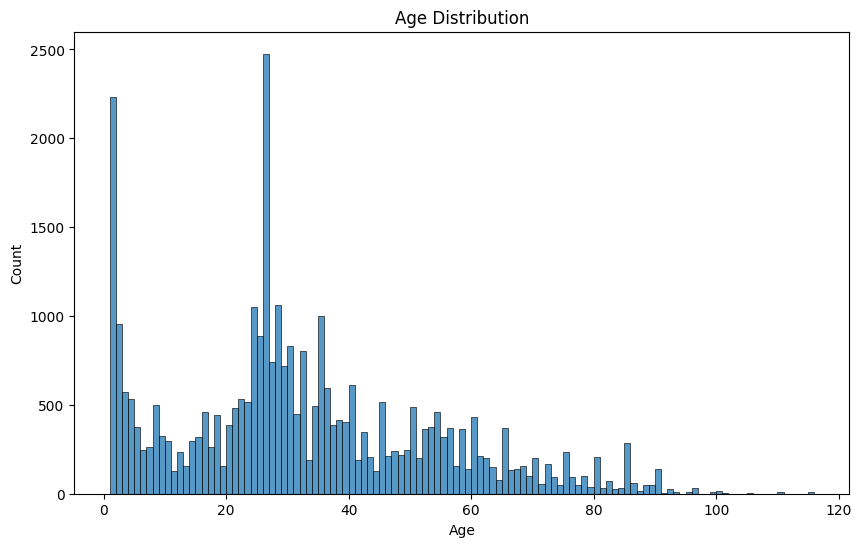

In [ ]:
age_group_counts = df['Ages'].value_counts().sort_index()

plt.figure(figsize=(10, 6))
sns.histplot(df['Ages'], bins=range(df['Ages'].min(), df['Ages'].max() + 1), kde=False)
plt.title('Age Distribution')
plt.xlabel('Age')
plt.ylabel('Count')
plt.show()

AgeGroup
(0, 10]      6304
(10, 20]     2840
(20, 30]     9307
(30, 40]     5349
(40, 50]     2795
(50, 60]     3181
(60, 70]     1744
(70, 80]     1082
(80, 90]      756
(90, 100]     106
Name: count, dtype: int64


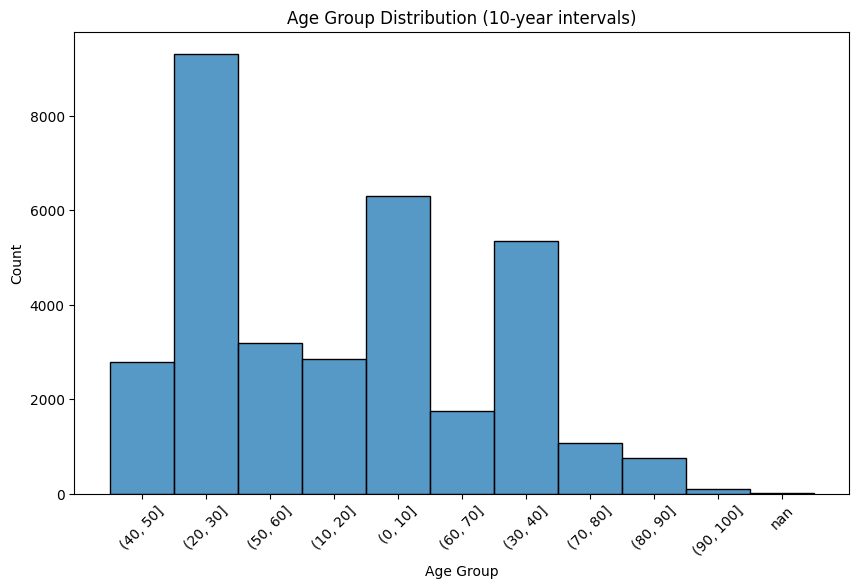

In [ ]:
images = pd.Series(images, name='Images')
ages = pd.Series(ages, name='Ages')
genders = pd.Series(genders, name='Genders')

df = pd.concat([images, ages, genders], axis=1)

df['AgeGroup'] = pd.cut(df['Ages'], bins=range(0, 101, 10))
age_group_counts = df['AgeGroup'].value_counts().sort_index()

print(age_group_counts)

plt.figure(figsize=(10, 6))
sns.histplot(df['AgeGroup'].astype(str), kde=False)
plt.title('Age Group Distribution (10-year intervals)')
plt.xlabel('Age Group')
plt.ylabel('Count')
plt.xticks(rotation=45)
plt.show()

In [ ]:
df['Ages'] = df['Ages'].apply(lambda x: 85 if x > 85 else x)

balanced_df = df.groupby('Ages').apply(lambda x: x.sample(min(len(x), 500))).reset_index(drop=True)
final_df = balanced_df.sample(n=15000, random_state=42).reset_index(drop=True)

In [ ]:
X = np.array([np.array(img.resize((128, 128))) / 255.0 for img in final_df['Images']])

In [ ]:
y_ages = final_df['Ages'].values

print(f"Total images: {len(X)}")
print(f"Age distribution: {np.bincount(y_ages)}")

Total images: 15000
Age distribution: [  0 302 277 297 281 226 139 154 283 204 169  80 137  92 158 186 267 146
 269  93 230 281 312 294 306 294 301 299 284 315 279 260 304 116 277 288
 286 244 249 250 280 111 187 130  62 281 120 144 126 146 299 112 212 219
 265 185 220 103 203  89 254 122 119  86  48 225  80  73  88  56 113  31
  92  55  30 127  55  27  57  25 120  19  36  17  19 303]


In [ ]:
y_genders = final_df['Genders'].values

print(f"Total people: {len(X)}")
print(f"gender distribution: {np.bincount(y_genders)}")

Total people: 15000
gender distribution: [7619 7380    0    1]


In [ ]:
y_age = final_df['Ages']
y_gender = final_df['Genders']

x_train_age, x_test_age, y_train_age, y_test_age = train_test_split(X, y_age, test_size=0.2, random_state=42)
x_train_gender, x_test_gender, y_train_gender, y_test_gender = train_test_split(X, y_gender, test_size=0.2, random_state=42)

x_train_age = np.array(x_train_age).reshape(-1, 128, 128, 3)
x_test_age = np.array(x_test_age).reshape(-1, 128, 128, 3)
x_train_gender = np.array(x_train_gender).reshape(-1, 128, 128, 3)
x_test_gender = np.array(x_test_gender).reshape(-1, 128, 128, 3)

In [ ]:
os.makedirs('models', exist_ok=True)

In [ ]:
early_stopping = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
model_checkpoint_age = ModelCheckpoint('models/best_agemodel.keras', monitor='val_loss', save_best_only=True)
model_checkpoint_gender = ModelCheckpoint('models/best_gendermodel.keras', monitor='val_loss', save_best_only=True)

reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=5, min_lr=0.00001)

tensorboard_age = TensorBoard(log_dir='logs/agemodel')
tensorboard_gender = TensorBoard(log_dir='logs/gendermodel')

In [ ]:
agemodel = Sequential()
agemodel.add(Conv2D(32, (3, 3), activation='relu', input_shape=(128, 128, 3)))
agemodel.add(MaxPooling2D((2, 2)))
agemodel.add(Conv2D(64, (3, 3), activation='relu'))
agemodel.add(MaxPooling2D((2, 2)))
agemodel.add(Conv2D(128, (3, 3), activation='relu'))
agemodel.add(MaxPooling2D((2, 2)))
agemodel.add(Flatten())
agemodel.add(Dense(128, activation='relu'))
agemodel.add(Dropout(0.5))
agemodel.add(Dense(64, activation='relu'))
agemodel.add(Dropout(0.5))
agemodel.add(Dense(1, activation='relu'))

agemodel.compile(loss='mean_squared_error',
                 optimizer=optimizers.Adam(learning_rate=0.0001))


In [ ]:
history_age = agemodel.fit(x_train_age, y_train_age,
                       epochs=200,
                       batch_size=32,
                       validation_data=(x_test_age, y_test_age),
                       callbacks=[early_stopping, model_checkpoint_age, reduce_lr, tensorboard_age])

Epoch 1/200
375/375 [==============================] - 15s 23ms/step - loss: 648.3938 - val_loss: 505.8249 - lr: 1.0000e-04
Epoch 2/200
375/375 [==============================] - 7s 18ms/step - loss: 482.5622 - val_loss: 293.3306 - lr: 1.0000e-04
Epoch 3/200
375/375 [==============================] - 7s 18ms/step - loss: 379.7940 - val_loss: 282.3060 - lr: 1.0000e-04
Epoch 4/200
375/375 [==============================] - 7s 18ms/step - loss: 337.0769 - val_loss: 217.1400 - lr: 1.0000e-04
Epoch 5/200
375/375 [==============================] - 7s 18ms/step - loss: 320.9202 - val_loss: 215.8446 - lr: 1.0000e-04
Epoch 6/200
375/375 [==============================] - 7s 18ms/step - loss: 298.1391 - val_loss: 198.0213 - lr: 1.0000e-04
Epoch 7/200
375/375 [==============================] - 7s 18ms/step - loss: 290.2317 - val_loss: 182.6504 - lr: 1.0000e-04
Epoch 8/200
375/375 [==============================] - 7s 18ms/step - loss: 275.2996 - val_loss: 182.1685 - lr: 1.0000e-04
Epoch 9/200
375

1/1 [==============================] - 0s 335ms/step


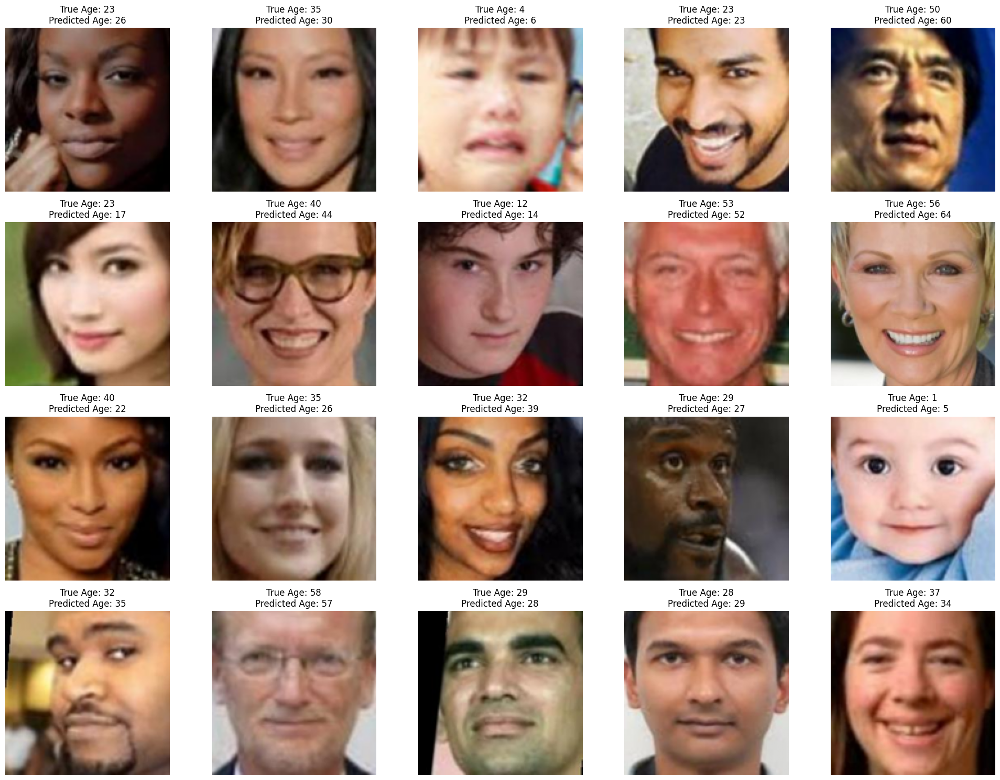

In [ ]:
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import numpy as np

best_agemodel = load_model('models/best_agemodel.keras')

num_samples = 20
random_indices = np.random.choice(x_test_age.shape[0], num_samples, replace=False)
sample_images = x_test_age[random_indices]
true_ages = y_test_age.iloc[random_indices].values

predicted_ages = best_agemodel.predict(sample_images)


plt.figure(figsize=(20, 15))
for i in range(num_samples):
    plt.subplot(4, 5, i+1)
    plt.imshow(sample_images[i])
    plt.title(f'True Age: {true_ages[i]}\nPredicted Age: {int(predicted_ages[i][0])}')
    plt.axis('off')
plt.tight_layout()
plt.show()


In [ ]:
genmodel = Sequential()
genmodel.add(Conv2D(32, (3, 3), activation='relu', input_shape=(128, 128, 3)))
genmodel.add(MaxPooling2D((2, 2)))
genmodel.add(Conv2D(64, (3, 3), activation='relu'))
genmodel.add(MaxPooling2D((2, 2)))
genmodel.add(Conv2D(128, (3, 3), activation='relu'))
genmodel.add(MaxPooling2D((2, 2)))
genmodel.add(Flatten())
genmodel.add(Dense(64, activation='relu'))
genmodel.add(Dropout(0.5))
genmodel.add(Dense(1, activation='sigmoid'))

genmodel.compile(loss='binary_crossentropy',
                 optimizer=optimizers.Adam(learning_rate=0.0001),
                 metrics=['accuracy'])

In [ ]:
history = genmodel.fit(x_train_gender, y_train_gender,
                       epochs=100,
                       batch_size=32,
                       validation_data=(x_test_gender, y_test_gender),
                       callbacks=[early_stopping, model_checkpoint_gender, reduce_lr, tensorboard_gender])

Epoch 1/100
375/375 [==============================] - 10s 22ms/step - loss: 0.5801 - accuracy: 0.6955 - val_loss: 0.4541 - val_accuracy: 0.8077 - lr: 1.0000e-04
Epoch 2/100
375/375 [==============================] - 7s 17ms/step - loss: 0.4159 - accuracy: 0.8137 - val_loss: 0.3431 - val_accuracy: 0.8533 - lr: 1.0000e-04
Epoch 3/100
375/375 [==============================] - 7s 18ms/step - loss: 0.3622 - accuracy: 0.8447 - val_loss: 0.3184 - val_accuracy: 0.8613 - lr: 1.0000e-04
Epoch 4/100
375/375 [==============================] - 7s 17ms/step - loss: 0.3309 - accuracy: 0.8617 - val_loss: 0.2940 - val_accuracy: 0.8733 - lr: 1.0000e-04
Epoch 5/100
375/375 [==============================] - 6s 17ms/step - loss: 0.3111 - accuracy: 0.8683 - val_loss: 0.3036 - val_accuracy: 0.8643 - lr: 1.0000e-04
Epoch 6/100
375/375 [==============================] - 7s 17ms/step - loss: 0.2932 - accuracy: 0.8766 - val_loss: 0.2703 - val_accuracy: 0.8790 - lr: 1.0000e-04
Epoch 7/100
375/375 [============

1/1 [==============================] - 0s 72ms/step


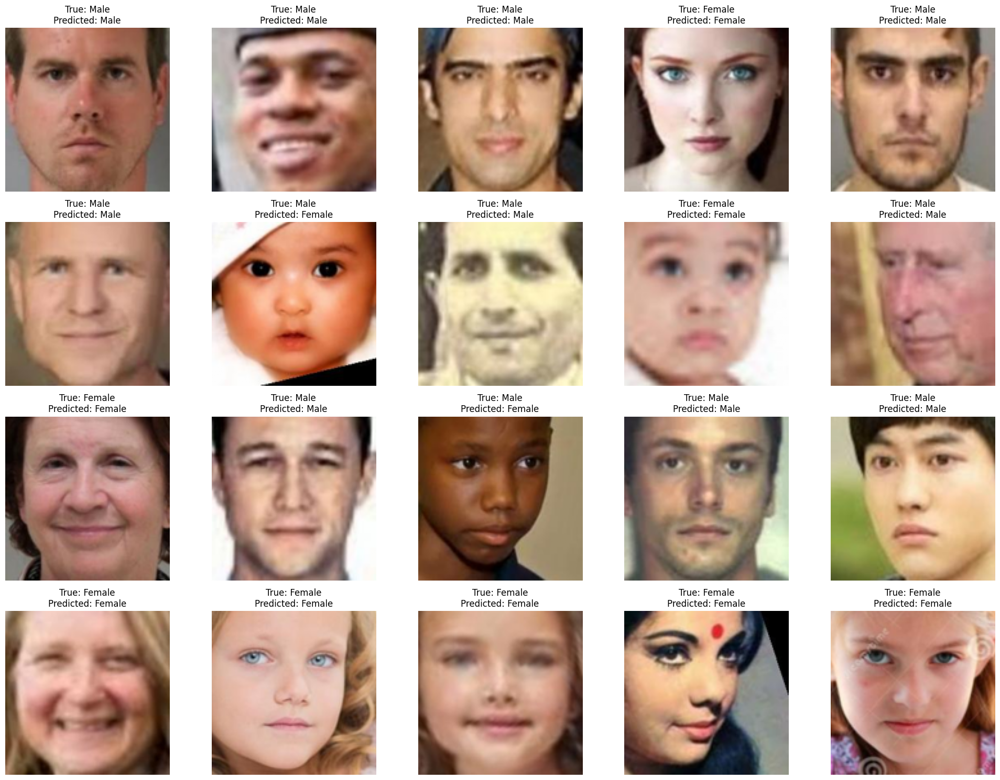

In [ ]:
from tensorflow.keras.models import load_model

best_model = load_model('models/best_gendermodel.keras')

num_samples = 20
random_indices = np.random.choice(x_test_gender.shape[0], num_samples, replace=False)
sample_images = x_test_gender[random_indices]
true_genders = y_test_gender.iloc[random_indices].values

predicted_genders = best_model.predict(sample_images).flatten()

plt.figure(figsize=(20, 15))
for i in range(num_samples):
    plt.subplot(4, 5, i+1)
    plt.imshow(sample_images[i])
    true_gender = 'Female' if true_genders[i] == 1 else 'Male'
    predicted_gender = 'Female' if predicted_genders[i] >= 0.5 else 'Male'
    plt.title(f'True: {true_gender}\nPredicted: {predicted_gender}')
    plt.axis('off')
plt.tight_layout()
plt.show()


In [26]:
# evaluate değerleri ekle

In [26]:
%load_ext tensorboard

In [27]:
%tensorboard --logdir logs/genmodel

<IPython.core.display.Javascript object>

In [28]:
%tensorboard --logdir logs/agemodel

<IPython.core.display.Javascript object>